# **Pre-trained ResNet-18 model trained on the KDEF dataset with input image resolution of 112x112.**

In [1]:
!pip install tensorboardX

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 101.7/101.7 kB 7.1 MB/s eta 0:00:00


In [2]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.optim import lr_scheduler
import numpy as np
import torchvision
from torchvision import datasets, models, transforms
import matplotlib.pyplot as plt
import time
from torch.utils.data import Dataset
import os
import copy
from tensorboardX import SummaryWriter
from PIL import Image
import torchvision.transforms as transforms
import random
plt.ion()   # interactive mode
%matplotlib inline

In [3]:
# Set fixed seed for reproducibility
seed = 42
random.seed(seed)
np.random.seed(seed)
torch.manual_seed(seed)
torch.cuda.manual_seed(seed)
torch.backends.cudnn.deterministic = True
torch.backends.cudnn.benchmark = False

In [4]:
from zipfile import ZipFile
import os

zip_path = '/content/KEDF_downsample_112x112.zip'

extract_to = '/content'

os.makedirs(extract_to, exist_ok=True)

with ZipFile(zip_path, 'r') as zip_ref:
    zip_ref.extractall(extract_to)

print(f'✅ Files extracted to: {extract_to}')

✅ Files extracted to: /content


In [5]:
import os

classes = {
    "AF": 0, "AN": 1, "DI": 2, "HA": 3, "NE": 4, "SA": 5, "SU": 6
}

root='/content/KEDF_downsample_112x112'
invalid_files = []

for path, subdirs, files in os.walk(root):
    for name in files:
        if len(name) >= 6:
            emotion_code = name[4:6]
            if emotion_code not in classes:
                invalid_files.append(os.path.join(path, name))

# Print the problematic files
print("Found {} problematic files:".format(len(invalid_files)))
for file in invalid_files:
    print(file)

Found 0 problematic files:


In [6]:
class KDEFDataset(Dataset):
    def __init__(self, root='/content/KEDF_downsample_112x112', transforms_=None, idx=[]):
        self.transform = transforms_
        self.files = []

        for path, subdirs, files in os.walk(root):
            for name in files:
                self.files.append(os.path.join(path, name))

        self.files =  [self.files[i] for i in idx]
        self.classes = {
             "AF":0,
             "AN":1,
             "DI":2,
             "HA":3,
             "NE":4,
             "SA":5,
             "SU":6
        }
        for f in self.files:
          name = f.split('/')[-1]
          emotion_code = name[4:6]
          if emotion_code not in self.classes:
              print(f"Invalid file: {f} (code: {emotion_code})")

        for index in range(4900):
            filepath = self.files[index % len(self.files)]
            filename = filepath.split('/')[-1]
            if filename[4:6] not in self.classes:
                print(filepath)

    def __getitem__(self, index):
        filepath = self.files[index % len(self.files)]

        filename = filepath.split('/')[-1]
        img = self.transform(Image.open(filepath))
        label = self.classes[filename[4:6]]

        return img, label

    def __len__(self):
        return len(self.files)

Load Data
---------


In [7]:
data_transforms = {
    'train': transforms.Compose([
        transforms.Resize(224),
        transforms.CenterCrop(224),
        transforms.RandomHorizontalFlip(),
        transforms.ToTensor(),
        transforms.Normalize([0.5, 0.5, 0.5], [0.5, 0.5, 0.5])
    ]),
    'val': transforms.Compose([
        transforms.Resize(224),
        transforms.CenterCrop(224),
        transforms.ToTensor(),
        transforms.Normalize([0.5, 0.5, 0.5], [0.5, 0.5, 0.5])
    ]),
}

idx = np.random.permutation(4900)
idx = {'val': idx[0:490], 'train': idx[490:]}

g = torch.Generator()
g.manual_seed(42)

dataloaders = {
    x: torch.utils.data.DataLoader(
        KDEFDataset(transforms_=data_transforms[x], idx=idx[x]),
        batch_size=32,
        shuffle=True,
        generator=g
    )
    for x in ['train', 'val']
}

dataset_sizes = {x: len(idx[x]) for x in ['train', 'val']}
class_names = 7

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

# Visualize a few images


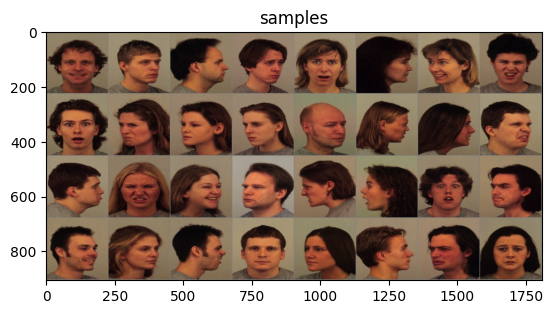

In [8]:
def imshow(inp, title=None):
    """Imshow for Tensor."""
    inp = inp.numpy().transpose((1, 2, 0))
    mean = np.array([0.5, 0.5, 0.5])
    std = np.array([0.5, 0.5, 0.5])
    inp = std * inp + mean
    inp = np.clip(inp, 0, 1)
    plt.imshow(inp)
    if title is not None:
        plt.title(title)
    plt.pause(0.001)  # pause a bit so that plots are updated


# Get a batch of training data
inputs, classes = next(iter(dataloaders['train']))

# Make a grid from batch
out = torchvision.utils.make_grid(inputs)

imshow(out, title='samples')

Training the model
------------------

Now, let's write a general function to train a model. Here, we will
illustrate:

-  Scheduling the learning rate
-  Saving the best model

In the following, parameter ``scheduler`` is an LR scheduler object from
``torch.optim.lr_scheduler``.



In [9]:
from tqdm import tqdm

def train_model(model, criterion, optimizer, scheduler, dataloaders, writer=None, i=0,  num_epochs=25):
    since = time.time()

    best_model_wts = copy.deepcopy(model.state_dict())
    best_acc = 0.0

    for epoch in range(num_epochs):
        print('Epoch {}/{}'.format(epoch, num_epochs - 1))
        print('-' * 10)

        # Each epoch has a training and validation phase
        for phase in ['train', 'val']:
            if phase == 'train':
                scheduler.step()
                model.train()  # Set model to training mode
            else:
                model.eval()   # Set model to evaluate mode

            running_loss = 0.0
            running_corrects = 0

            # Iterate over data.
            for inputs, labels in tqdm(dataloaders[phase]):
                inputs = inputs.to(device)
                labels = labels.to(device)

                # zero the parameter gradients
                optimizer.zero_grad()

                # forward
                # track history if only in train
                with torch.set_grad_enabled(phase == 'train'):
                    outputs = model(inputs)
                    _, preds = torch.max(outputs, 1)
                    loss = criterion(outputs, labels)

                    # backward + optimize only if in training phase
                    if phase == 'train':
                        loss.backward()
                        optimizer.step()

                # statistics
                running_loss += loss.item() * inputs.size(0)
                running_corrects += torch.sum(preds == labels.data)

            epoch_loss = running_loss / dataset_sizes[phase]
            epoch_acc = running_corrects.double() / dataset_sizes[phase]

            print('{} Loss: {:.4f} Acc: {:.4f}'.format(
                phase, epoch_loss, epoch_acc))


            writer.add_scalar(phase+"/loss", epoch_loss, epoch)
            writer.add_scalar(phase+"/acc", epoch_acc, epoch)


            # deep copy the model
            if phase == 'val' and epoch_acc > best_acc:
                best_acc = epoch_acc
                best_model_wts = copy.deepcopy(model.state_dict())
                torch.save(model.state_dict(), 'saved/resnet_'+str(i)+'.pt')

        print()


    time_elapsed = time.time() - since
    print('Training complete in {:.0f}m {:.0f}s'.format(
        time_elapsed // 60, time_elapsed % 60))
    print('Best val Acc: {:4f}'.format(best_acc))

    # load best model weights
    model.load_state_dict(best_model_wts)
    return model, best_acc

Visualizing the model predictions

In [10]:
import imageio
import os
import matplotlib.pyplot as plt
from PIL import Image, ImageDraw, ImageFont

def visualize_model_misclassified(model, dataloader, class_names, save_dir='misclassified', num_images=15, columns=3):
    os.makedirs(save_dir, exist_ok=True)
    was_training = model.training
    model.eval()
    images_so_far = 0
    rows = (num_images + columns - 1) // columns
    fig, axes = plt.subplots(rows, columns, figsize=(columns * 4, rows * 4))
    axes = axes.flatten()

    with torch.no_grad():
        for inputs, labels in dataloader:
            inputs = inputs.to(device)
            labels = labels.to(device)

            outputs = model(inputs)
            _, preds = torch.max(outputs, 1)

            for j in range(inputs.size()[0]):
                if preds[j] != labels[j]:
                    if images_so_far >= num_images:
                        break

                    # --- Display in grid ---
                    ax = axes[images_so_far]
                    ax.axis('off')
                    ax.set_title(f'Pred: {class_names[int(preds[j])]},\nTrue: {class_names[int(labels[j])]}', fontsize=9)
                    imshow(inputs.cpu().data[j], ax=ax)

                    # --- Save image with overlay text ---
                    img = inputs[j].cpu().numpy().transpose(1, 2, 0)
                    img = (img * 0.5 + 0.5) * 255
                    img = img.astype(np.uint8)
                    img_pil = Image.fromarray(img)

                    draw = ImageDraw.Draw(img_pil)
                    font = ImageFont.load_default()
                    text = f'Predicted: {class_names[int(preds[j])]} | True: {class_names[int(labels[j])]}'
                    draw.rectangle([10, 10, 280, 25], fill=(255, 255, 255))
                    draw.text((10, 10), text, font=font, fill=(0, 0, 0))

                    img_pil.save(f'{save_dir}/misclassified_{images_so_far + 1}.jpg')

                    images_so_far += 1

    for k in range(images_so_far, len(axes)):
        axes[k].axis('off')

    plt.tight_layout()
    plt.show()
    model.train(mode=was_training)


def imshow(inp, ax=None, title=None):
    inp = inp.numpy().transpose((1, 2, 0))
    mean = np.array([0.5, 0.5, 0.5])
    std = np.array([0.5, 0.5, 0.5])
    inp = std * inp + mean
    inp = np.clip(inp, 0, 1)
    if ax is None:
        plt.imshow(inp)
    else:
        ax.imshow(inp)
    if title is not None:
        ax.set_title(title)


Finetuning the convnet
----------------------

Load a pretrained model and reset final fully connected layer.




Downloading: "https://download.pytorch.org/models/resnet18-f37072fd.pth" to /root/.cache/torch/hub/checkpoints/resnet18-f37072fd.pth
100%|██████████| 44.7M/44.7M [00:00<00:00, 215MB/s]
/usr/local/lib/python3.11/dist-packages/torch/optim/lr_scheduler.py:227: UserWarning: Detected call of `lr_scheduler.step()` before `optimizer.step()`. In PyTorch 1.1.0 and later, you should call them in the opposite order: `optimizer.step()` before `lr_scheduler.step()`.  Failure to do this will result in PyTorch skipping the first value of the learning rate schedule. See more details at https://pytorch.org/docs/stable/optim.html#how-to-adjust-learning-rate
  warnings.warn(


Epoch 0/19
----------


100%|██████████| 138/138 [00:12<00:00, 11.21it/s]


train Loss: 1.5918 Acc: 0.3737


100%|██████████| 16/16 [00:00<00:00, 17.11it/s]


val Loss: 1.1569 Acc: 0.5714

Epoch 1/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.60it/s]


train Loss: 0.8114 Acc: 0.7100


100%|██████████| 16/16 [00:00<00:00, 16.91it/s]


val Loss: 0.7051 Acc: 0.7490

Epoch 2/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.49it/s]


train Loss: 0.4872 Acc: 0.8363


100%|██████████| 16/16 [00:00<00:00, 18.34it/s]


val Loss: 0.5046 Acc: 0.7918

Epoch 3/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.14it/s]


train Loss: 0.3240 Acc: 0.8905


100%|██████████| 16/16 [00:00<00:00, 18.18it/s]


val Loss: 0.3883 Acc: 0.8592

Epoch 4/19
----------


100%|██████████| 138/138 [00:09<00:00, 13.80it/s]


train Loss: 0.2163 Acc: 0.9302


100%|██████████| 16/16 [00:00<00:00, 18.16it/s]


val Loss: 0.3283 Acc: 0.8918

Epoch 5/19
----------


100%|██████████| 138/138 [00:09<00:00, 13.82it/s]


train Loss: 0.1353 Acc: 0.9630


100%|██████████| 16/16 [00:00<00:00, 18.20it/s]


val Loss: 0.2713 Acc: 0.9082

Epoch 6/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.47it/s]


train Loss: 0.1144 Acc: 0.9728


100%|██████████| 16/16 [00:00<00:00, 17.81it/s]


val Loss: 0.2514 Acc: 0.9163

Epoch 7/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.52it/s]


train Loss: 0.1085 Acc: 0.9748


100%|██████████| 16/16 [00:00<00:00, 18.12it/s]


val Loss: 0.2472 Acc: 0.9224

Epoch 8/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.56it/s]


train Loss: 0.1016 Acc: 0.9762


100%|██████████| 16/16 [00:00<00:00, 17.28it/s]


val Loss: 0.2377 Acc: 0.9184

Epoch 9/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.77it/s]


train Loss: 0.1012 Acc: 0.9757


100%|██████████| 16/16 [00:00<00:00, 17.91it/s]


val Loss: 0.2441 Acc: 0.9224

Epoch 10/19
----------


100%|██████████| 138/138 [00:09<00:00, 13.89it/s]


train Loss: 0.0920 Acc: 0.9819


100%|██████████| 16/16 [00:00<00:00, 17.22it/s]


val Loss: 0.2335 Acc: 0.9204

Epoch 11/19
----------


100%|██████████| 138/138 [00:09<00:00, 13.97it/s]


train Loss: 0.0841 Acc: 0.9823


100%|██████████| 16/16 [00:00<00:00, 17.62it/s]


val Loss: 0.2403 Acc: 0.9204

Epoch 12/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.80it/s]


train Loss: 0.0874 Acc: 0.9798


100%|██████████| 16/16 [00:00<00:00, 18.37it/s]


val Loss: 0.2314 Acc: 0.9265

Epoch 13/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.74it/s]


train Loss: 0.0912 Acc: 0.9828


100%|██████████| 16/16 [00:00<00:00, 18.15it/s]


val Loss: 0.2346 Acc: 0.9204

Epoch 14/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.75it/s]


train Loss: 0.0875 Acc: 0.9807


100%|██████████| 16/16 [00:00<00:00, 18.38it/s]


val Loss: 0.2386 Acc: 0.9224

Epoch 15/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.73it/s]


train Loss: 0.0865 Acc: 0.9807


100%|██████████| 16/16 [00:00<00:00, 18.19it/s]


val Loss: 0.2371 Acc: 0.9245

Epoch 16/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.77it/s]


train Loss: 0.0833 Acc: 0.9830


100%|██████████| 16/16 [00:00<00:00, 18.61it/s]


val Loss: 0.2345 Acc: 0.9245

Epoch 17/19
----------


100%|██████████| 138/138 [00:09<00:00, 13.86it/s]


train Loss: 0.0835 Acc: 0.9830


100%|██████████| 16/16 [00:00<00:00, 18.36it/s]


val Loss: 0.2352 Acc: 0.9265

Epoch 18/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.72it/s]


train Loss: 0.0816 Acc: 0.9855


100%|██████████| 16/16 [00:00<00:00, 18.04it/s]


val Loss: 0.2337 Acc: 0.9224

Epoch 19/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.70it/s]


train Loss: 0.0846 Acc: 0.9810


100%|██████████| 16/16 [00:00<00:00, 18.30it/s]


val Loss: 0.2329 Acc: 0.9265

Training complete in 3m 43s
Best val Acc: 0.926531
Showing misclassified examples for fold 0...


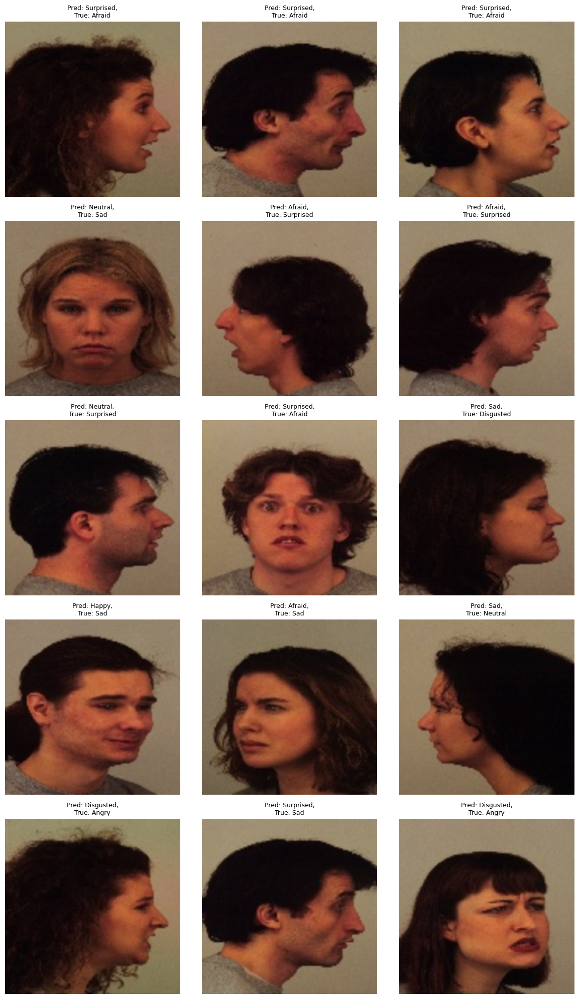




------------------------------------
 Accuracies  [0.9265306122448981]



Epoch 0/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.56it/s]


train Loss: 1.5890 Acc: 0.3755


100%|██████████| 16/16 [00:00<00:00, 18.07it/s]


val Loss: 1.0620 Acc: 0.6327

Epoch 1/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.74it/s]


train Loss: 0.7989 Acc: 0.7120


100%|██████████| 16/16 [00:00<00:00, 17.38it/s]


val Loss: 0.6643 Acc: 0.7469

Epoch 2/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.51it/s]


train Loss: 0.4735 Acc: 0.8367


100%|██████████| 16/16 [00:00<00:00, 17.93it/s]


val Loss: 0.4197 Acc: 0.8571

Epoch 3/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.60it/s]


train Loss: 0.3278 Acc: 0.8864


100%|██████████| 16/16 [00:00<00:00, 18.06it/s]


val Loss: 0.3470 Acc: 0.8735

Epoch 4/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.61it/s]


train Loss: 0.2182 Acc: 0.9311


100%|██████████| 16/16 [00:00<00:00, 18.12it/s]


val Loss: 0.2377 Acc: 0.9122

Epoch 5/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.41it/s]


train Loss: 0.1388 Acc: 0.9637


100%|██████████| 16/16 [00:00<00:00, 18.00it/s]


val Loss: 0.2054 Acc: 0.9163

Epoch 6/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.41it/s]


train Loss: 0.1179 Acc: 0.9676


100%|██████████| 16/16 [00:00<00:00, 17.34it/s]


val Loss: 0.1978 Acc: 0.9286

Epoch 7/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.37it/s]


train Loss: 0.1114 Acc: 0.9751


100%|██████████| 16/16 [00:00<00:00, 17.33it/s]


val Loss: 0.2010 Acc: 0.9245

Epoch 8/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.34it/s]


train Loss: 0.1157 Acc: 0.9714


100%|██████████| 16/16 [00:00<00:00, 17.71it/s]


val Loss: 0.1900 Acc: 0.9286

Epoch 9/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.36it/s]


train Loss: 0.1047 Acc: 0.9739


100%|██████████| 16/16 [00:00<00:00, 17.76it/s]


val Loss: 0.1871 Acc: 0.9245

Epoch 10/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.42it/s]


train Loss: 0.0940 Acc: 0.9798


100%|██████████| 16/16 [00:00<00:00, 17.75it/s]


val Loss: 0.1958 Acc: 0.9245

Epoch 11/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.35it/s]


train Loss: 0.0950 Acc: 0.9791


100%|██████████| 16/16 [00:00<00:00, 17.40it/s]


val Loss: 0.1889 Acc: 0.9367

Epoch 12/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.56it/s]


train Loss: 0.0898 Acc: 0.9789


100%|██████████| 16/16 [00:00<00:00, 17.96it/s]


val Loss: 0.1853 Acc: 0.9265

Epoch 13/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.45it/s]


train Loss: 0.0870 Acc: 0.9821


100%|██████████| 16/16 [00:00<00:00, 18.01it/s]


val Loss: 0.1841 Acc: 0.9286

Epoch 14/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.60it/s]


train Loss: 0.0866 Acc: 0.9830


100%|██████████| 16/16 [00:00<00:00, 17.74it/s]


val Loss: 0.1858 Acc: 0.9204

Epoch 15/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.45it/s]


train Loss: 0.0800 Acc: 0.9853


100%|██████████| 16/16 [00:00<00:00, 17.95it/s]


val Loss: 0.1858 Acc: 0.9347

Epoch 16/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.57it/s]


train Loss: 0.0919 Acc: 0.9803


100%|██████████| 16/16 [00:00<00:00, 17.78it/s]


val Loss: 0.1869 Acc: 0.9367

Epoch 17/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.42it/s]


train Loss: 0.0862 Acc: 0.9834


100%|██████████| 16/16 [00:00<00:00, 17.93it/s]


val Loss: 0.1892 Acc: 0.9204

Epoch 18/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.54it/s]


train Loss: 0.0832 Acc: 0.9846


100%|██████████| 16/16 [00:00<00:00, 18.21it/s]


val Loss: 0.1832 Acc: 0.9245

Epoch 19/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.56it/s]


train Loss: 0.0879 Acc: 0.9839


100%|██████████| 16/16 [00:00<00:00, 17.75it/s]


val Loss: 0.1815 Acc: 0.9327

Training complete in 3m 44s
Best val Acc: 0.936735
Showing misclassified examples for fold 1...


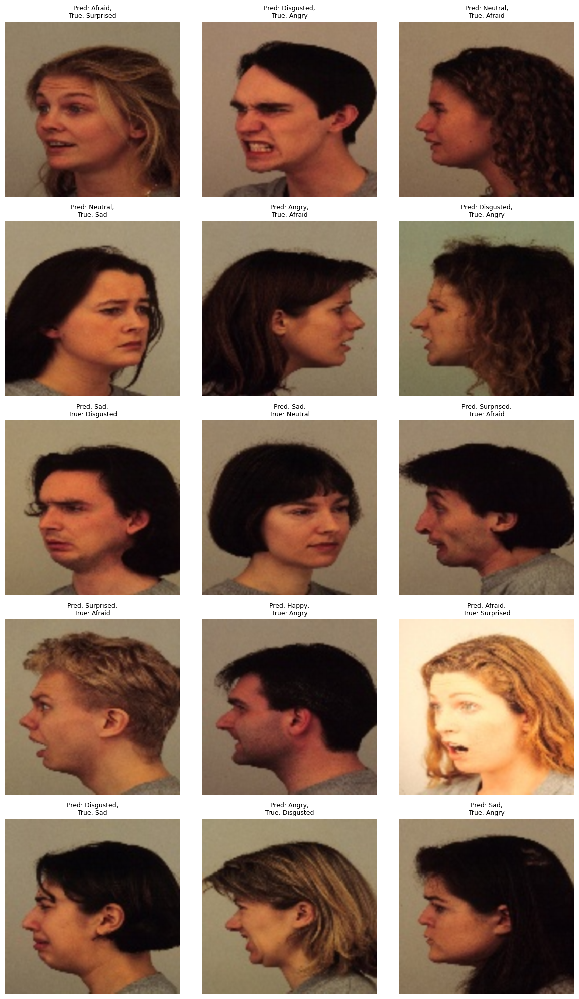




------------------------------------
 Accuracies  [0.9265306122448981, 0.9367346938775512]



Epoch 0/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.23it/s]


train Loss: 1.5946 Acc: 0.3839


100%|██████████| 16/16 [00:00<00:00, 17.69it/s]


val Loss: 1.1386 Acc: 0.5694

Epoch 1/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.13it/s]


train Loss: 0.7371 Acc: 0.7415


100%|██████████| 16/16 [00:00<00:00, 16.97it/s]


val Loss: 0.5783 Acc: 0.7796

Epoch 2/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.27it/s]


train Loss: 0.4264 Acc: 0.8556


100%|██████████| 16/16 [00:00<00:00, 17.41it/s]


val Loss: 0.4343 Acc: 0.8531

Epoch 3/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.17it/s]


train Loss: 0.2796 Acc: 0.9052


100%|██████████| 16/16 [00:00<00:00, 17.09it/s]


val Loss: 0.4383 Acc: 0.8306

Epoch 4/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.17it/s]


train Loss: 0.2129 Acc: 0.9338


100%|██████████| 16/16 [00:00<00:00, 16.98it/s]


val Loss: 0.3043 Acc: 0.8980

Epoch 5/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.38it/s]


train Loss: 0.1314 Acc: 0.9673


100%|██████████| 16/16 [00:00<00:00, 16.21it/s]


val Loss: 0.2777 Acc: 0.8796

Epoch 6/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.34it/s]


train Loss: 0.1088 Acc: 0.9737


100%|██████████| 16/16 [00:00<00:00, 16.96it/s]


val Loss: 0.2588 Acc: 0.8918

Epoch 7/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.37it/s]


train Loss: 0.1003 Acc: 0.9766


100%|██████████| 16/16 [00:00<00:00, 16.21it/s]


val Loss: 0.2604 Acc: 0.9020

Epoch 8/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.16it/s]


train Loss: 0.0978 Acc: 0.9773


100%|██████████| 16/16 [00:00<00:00, 16.68it/s]


val Loss: 0.2591 Acc: 0.8918

Epoch 9/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.32it/s]


train Loss: 0.1016 Acc: 0.9744


100%|██████████| 16/16 [00:00<00:00, 18.06it/s]


val Loss: 0.2641 Acc: 0.9000

Epoch 10/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.38it/s]


train Loss: 0.0956 Acc: 0.9766


100%|██████████| 16/16 [00:00<00:00, 16.25it/s]


val Loss: 0.2682 Acc: 0.9041

Epoch 11/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.38it/s]


train Loss: 0.0824 Acc: 0.9832


100%|██████████| 16/16 [00:00<00:00, 17.96it/s]


val Loss: 0.2570 Acc: 0.9041

Epoch 12/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.44it/s]


train Loss: 0.0816 Acc: 0.9848


100%|██████████| 16/16 [00:00<00:00, 16.19it/s]


val Loss: 0.2490 Acc: 0.9000

Epoch 13/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.25it/s]


train Loss: 0.0802 Acc: 0.9839


100%|██████████| 16/16 [00:00<00:00, 17.34it/s]


val Loss: 0.2583 Acc: 0.8959

Epoch 14/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.41it/s]


train Loss: 0.0801 Acc: 0.9839


100%|██████████| 16/16 [00:00<00:00, 17.61it/s]


val Loss: 0.2585 Acc: 0.9041

Epoch 15/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.46it/s]


train Loss: 0.0845 Acc: 0.9828


100%|██████████| 16/16 [00:00<00:00, 17.22it/s]


val Loss: 0.2501 Acc: 0.9020

Epoch 16/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.61it/s]


train Loss: 0.0813 Acc: 0.9814


100%|██████████| 16/16 [00:00<00:00, 16.35it/s]


val Loss: 0.2546 Acc: 0.9000

Epoch 17/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.58it/s]


train Loss: 0.0788 Acc: 0.9859


100%|██████████| 16/16 [00:00<00:00, 17.71it/s]


val Loss: 0.2517 Acc: 0.9041

Epoch 18/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.40it/s]


train Loss: 0.0769 Acc: 0.9844


100%|██████████| 16/16 [00:00<00:00, 17.13it/s]


val Loss: 0.2535 Acc: 0.9061

Epoch 19/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.36it/s]


train Loss: 0.0788 Acc: 0.9830


100%|██████████| 16/16 [00:00<00:00, 16.85it/s]


val Loss: 0.2531 Acc: 0.9000

Training complete in 3m 47s
Best val Acc: 0.906122
Showing misclassified examples for fold 2...


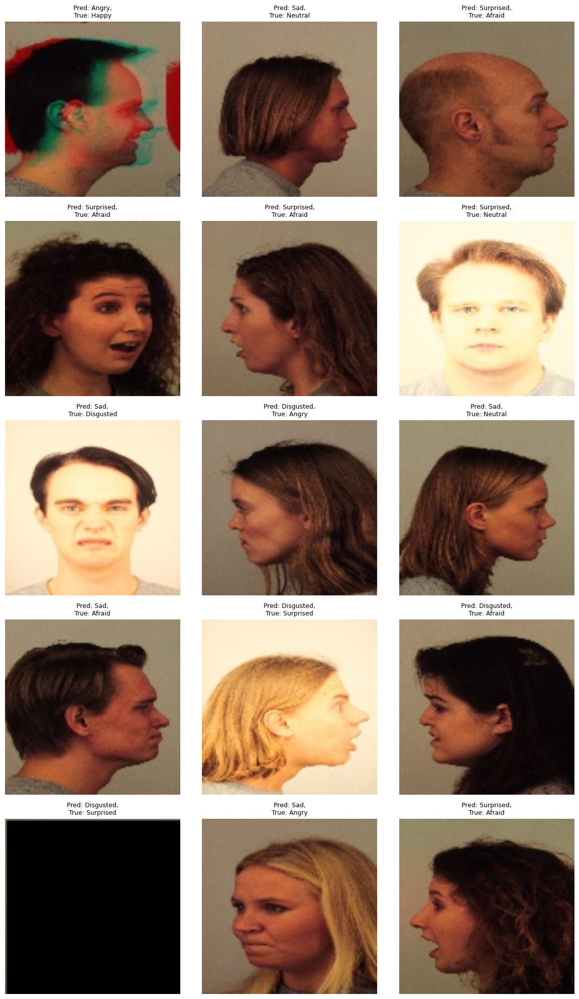




------------------------------------
 Accuracies  [0.9265306122448981, 0.9367346938775512, 0.9061224489795919]



Epoch 0/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.38it/s]


train Loss: 1.5588 Acc: 0.3964


100%|██████████| 16/16 [00:01<00:00, 15.96it/s]


val Loss: 1.0313 Acc: 0.6469

Epoch 1/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.25it/s]


train Loss: 0.7463 Acc: 0.7322


100%|██████████| 16/16 [00:00<00:00, 17.38it/s]


val Loss: 0.6110 Acc: 0.7735

Epoch 2/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.27it/s]


train Loss: 0.4457 Acc: 0.8454


100%|██████████| 16/16 [00:00<00:00, 16.30it/s]


val Loss: 0.5127 Acc: 0.8082

Epoch 3/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.25it/s]


train Loss: 0.2977 Acc: 0.8998


100%|██████████| 16/16 [00:00<00:00, 16.47it/s]


val Loss: 0.3380 Acc: 0.8653

Epoch 4/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.07it/s]


train Loss: 0.2032 Acc: 0.9404


100%|██████████| 16/16 [00:01<00:00, 15.85it/s]


val Loss: 0.3329 Acc: 0.8776

Epoch 5/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.10it/s]


train Loss: 0.1306 Acc: 0.9630


100%|██████████| 16/16 [00:01<00:00, 15.62it/s]


val Loss: 0.2546 Acc: 0.9041

Epoch 6/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.07it/s]


train Loss: 0.1141 Acc: 0.9710


100%|██████████| 16/16 [00:00<00:00, 16.83it/s]


val Loss: 0.2446 Acc: 0.9061

Epoch 7/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.32it/s]


train Loss: 0.1030 Acc: 0.9751


100%|██████████| 16/16 [00:00<00:00, 17.77it/s]


val Loss: 0.2527 Acc: 0.9102

Epoch 8/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.40it/s]


train Loss: 0.0988 Acc: 0.9766


100%|██████████| 16/16 [00:01<00:00, 15.98it/s]


val Loss: 0.2478 Acc: 0.9102

Epoch 9/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.33it/s]


train Loss: 0.0949 Acc: 0.9771


100%|██████████| 16/16 [00:01<00:00, 15.29it/s]


val Loss: 0.2411 Acc: 0.9204

Epoch 10/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.38it/s]


train Loss: 0.0878 Acc: 0.9846


100%|██████████| 16/16 [00:00<00:00, 17.53it/s]


val Loss: 0.2373 Acc: 0.9184

Epoch 11/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.14it/s]


train Loss: 0.0862 Acc: 0.9819


100%|██████████| 16/16 [00:01<00:00, 15.68it/s]


val Loss: 0.2397 Acc: 0.9163

Epoch 12/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.15it/s]


train Loss: 0.0833 Acc: 0.9816


100%|██████████| 16/16 [00:00<00:00, 16.91it/s]


val Loss: 0.2400 Acc: 0.9102

Epoch 13/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.34it/s]


train Loss: 0.0828 Acc: 0.9828


100%|██████████| 16/16 [00:00<00:00, 17.01it/s]


val Loss: 0.2415 Acc: 0.9102

Epoch 14/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.34it/s]


train Loss: 0.0806 Acc: 0.9832


100%|██████████| 16/16 [00:00<00:00, 17.84it/s]


val Loss: 0.2341 Acc: 0.9245

Epoch 15/19
----------


100%|██████████| 138/138 [00:10<00:00, 12.91it/s]


train Loss: 0.0789 Acc: 0.9837


100%|██████████| 16/16 [00:00<00:00, 16.52it/s]


val Loss: 0.2440 Acc: 0.9122

Epoch 16/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.50it/s]


train Loss: 0.0766 Acc: 0.9871


100%|██████████| 16/16 [00:00<00:00, 17.55it/s]


val Loss: 0.2342 Acc: 0.9082

Epoch 17/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.45it/s]


train Loss: 0.0753 Acc: 0.9866


100%|██████████| 16/16 [00:00<00:00, 18.18it/s]


val Loss: 0.2404 Acc: 0.9163

Epoch 18/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.30it/s]


train Loss: 0.0799 Acc: 0.9839


100%|██████████| 16/16 [00:00<00:00, 17.04it/s]


val Loss: 0.2411 Acc: 0.9143

Epoch 19/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.51it/s]


train Loss: 0.0813 Acc: 0.9855


100%|██████████| 16/16 [00:00<00:00, 17.69it/s]


val Loss: 0.2427 Acc: 0.9020

Training complete in 3m 48s
Best val Acc: 0.924490
Showing misclassified examples for fold 3...


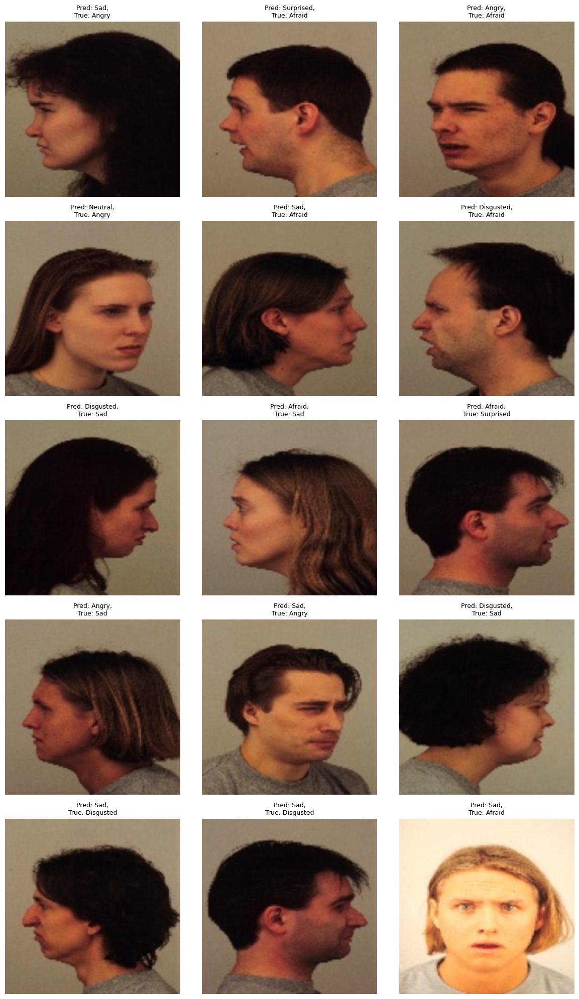




------------------------------------
 Accuracies  [0.9265306122448981, 0.9367346938775512, 0.9061224489795919, 0.9244897959183674]



Epoch 0/19
----------


100%|██████████| 138/138 [00:10<00:00, 12.97it/s]


train Loss: 1.6041 Acc: 0.3671


100%|██████████| 16/16 [00:00<00:00, 17.97it/s]


val Loss: 1.1137 Acc: 0.6000

Epoch 1/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.41it/s]


train Loss: 0.8066 Acc: 0.7084


100%|██████████| 16/16 [00:01<00:00, 15.97it/s]


val Loss: 0.5619 Acc: 0.8122

Epoch 2/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.03it/s]


train Loss: 0.4874 Acc: 0.8306


100%|██████████| 16/16 [00:00<00:00, 17.93it/s]


val Loss: 0.5319 Acc: 0.8082

Epoch 3/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.38it/s]


train Loss: 0.3145 Acc: 0.8941


100%|██████████| 16/16 [00:00<00:00, 17.49it/s]


val Loss: 0.3177 Acc: 0.9122

Epoch 4/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.39it/s]


train Loss: 0.2203 Acc: 0.9277


100%|██████████| 16/16 [00:00<00:00, 16.70it/s]


val Loss: 0.2632 Acc: 0.9041

Epoch 5/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.53it/s]


train Loss: 0.1408 Acc: 0.9628


100%|██████████| 16/16 [00:00<00:00, 17.68it/s]


val Loss: 0.1718 Acc: 0.9429

Epoch 6/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.29it/s]


train Loss: 0.1142 Acc: 0.9719


100%|██████████| 16/16 [00:00<00:00, 16.32it/s]


val Loss: 0.1772 Acc: 0.9388

Epoch 7/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.36it/s]


train Loss: 0.1152 Acc: 0.9714


100%|██████████| 16/16 [00:00<00:00, 16.32it/s]


val Loss: 0.1685 Acc: 0.9510

Epoch 8/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.21it/s]


train Loss: 0.1003 Acc: 0.9789


100%|██████████| 16/16 [00:00<00:00, 16.94it/s]


val Loss: 0.1592 Acc: 0.9510

Epoch 9/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.32it/s]


train Loss: 0.0966 Acc: 0.9791


100%|██████████| 16/16 [00:00<00:00, 17.73it/s]


val Loss: 0.1601 Acc: 0.9469

Epoch 10/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.30it/s]


train Loss: 0.0903 Acc: 0.9823


100%|██████████| 16/16 [00:01<00:00, 15.64it/s]


val Loss: 0.1571 Acc: 0.9490

Epoch 11/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.18it/s]


train Loss: 0.0859 Acc: 0.9816


100%|██████████| 16/16 [00:00<00:00, 17.97it/s]


val Loss: 0.1566 Acc: 0.9510

Epoch 12/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.13it/s]


train Loss: 0.0842 Acc: 0.9825


100%|██████████| 16/16 [00:00<00:00, 17.90it/s]


val Loss: 0.1533 Acc: 0.9469

Epoch 13/19
----------


100%|██████████| 138/138 [00:10<00:00, 12.77it/s]


train Loss: 0.0867 Acc: 0.9825


100%|██████████| 16/16 [00:01<00:00, 15.26it/s]


val Loss: 0.1539 Acc: 0.9510

Epoch 14/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.15it/s]


train Loss: 0.0851 Acc: 0.9844


100%|██████████| 16/16 [00:00<00:00, 17.47it/s]


val Loss: 0.1575 Acc: 0.9469

Epoch 15/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.21it/s]


train Loss: 0.0818 Acc: 0.9846


100%|██████████| 16/16 [00:00<00:00, 17.47it/s]


val Loss: 0.1625 Acc: 0.9429

Epoch 16/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.22it/s]


train Loss: 0.0823 Acc: 0.9828


100%|██████████| 16/16 [00:00<00:00, 17.71it/s]


val Loss: 0.1613 Acc: 0.9408

Epoch 17/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.22it/s]


train Loss: 0.0830 Acc: 0.9837


100%|██████████| 16/16 [00:01<00:00, 15.89it/s]


val Loss: 0.1577 Acc: 0.9449

Epoch 18/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.33it/s]


train Loss: 0.0828 Acc: 0.9844


100%|██████████| 16/16 [00:00<00:00, 17.69it/s]


val Loss: 0.1590 Acc: 0.9490

Epoch 19/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.22it/s]


train Loss: 0.0851 Acc: 0.9828


100%|██████████| 16/16 [00:00<00:00, 17.77it/s]


val Loss: 0.1614 Acc: 0.9490

Training complete in 3m 48s
Best val Acc: 0.951020
Showing misclassified examples for fold 4...


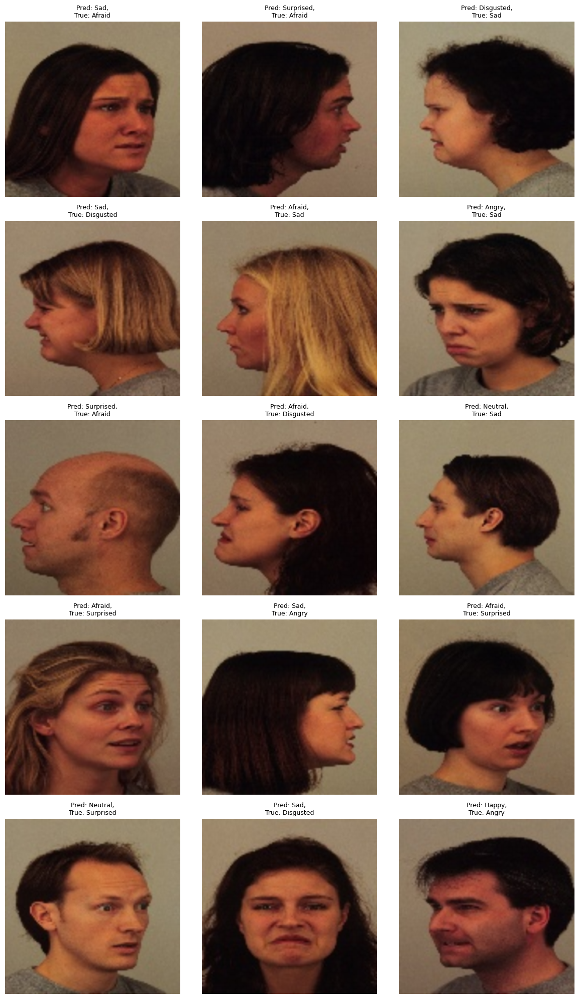




------------------------------------
 Accuracies  [0.9265306122448981, 0.9367346938775512, 0.9061224489795919, 0.9244897959183674, 0.9510204081632654]



Epoch 0/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.27it/s]


train Loss: 1.5766 Acc: 0.3810


100%|██████████| 16/16 [00:00<00:00, 17.25it/s]


val Loss: 0.9745 Acc: 0.6531

Epoch 1/19
----------


100%|██████████| 138/138 [00:10<00:00, 12.90it/s]


train Loss: 0.7534 Acc: 0.7345


100%|██████████| 16/16 [00:00<00:00, 17.74it/s]


val Loss: 0.5834 Acc: 0.7857

Epoch 2/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.08it/s]


train Loss: 0.4586 Acc: 0.8383


100%|██████████| 16/16 [00:00<00:00, 18.27it/s]


val Loss: 0.4415 Acc: 0.8571

Epoch 3/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.31it/s]


train Loss: 0.3002 Acc: 0.9039


100%|██████████| 16/16 [00:00<00:00, 18.23it/s]


val Loss: 0.4328 Acc: 0.8490

Epoch 4/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.09it/s]


train Loss: 0.2084 Acc: 0.9327


100%|██████████| 16/16 [00:00<00:00, 17.82it/s]


val Loss: 0.2866 Acc: 0.8918

Epoch 5/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.20it/s]


train Loss: 0.1257 Acc: 0.9664


100%|██████████| 16/16 [00:00<00:00, 17.85it/s]


val Loss: 0.2442 Acc: 0.9224

Epoch 6/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.18it/s]


train Loss: 0.1101 Acc: 0.9735


100%|██████████| 16/16 [00:00<00:00, 18.28it/s]


val Loss: 0.2375 Acc: 0.9204

Epoch 7/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.16it/s]


train Loss: 0.1041 Acc: 0.9780


100%|██████████| 16/16 [00:00<00:00, 18.11it/s]


val Loss: 0.2347 Acc: 0.9204

Epoch 8/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.42it/s]


train Loss: 0.1024 Acc: 0.9760


100%|██████████| 16/16 [00:00<00:00, 17.64it/s]


val Loss: 0.2318 Acc: 0.9245

Epoch 9/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.08it/s]


train Loss: 0.0920 Acc: 0.9778


100%|██████████| 16/16 [00:00<00:00, 17.59it/s]


val Loss: 0.2239 Acc: 0.9245

Epoch 10/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.09it/s]


train Loss: 0.0894 Acc: 0.9816


100%|██████████| 16/16 [00:00<00:00, 16.72it/s]


val Loss: 0.2157 Acc: 0.9286

Epoch 11/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.05it/s]


train Loss: 0.0880 Acc: 0.9803


100%|██████████| 16/16 [00:00<00:00, 18.00it/s]


val Loss: 0.2144 Acc: 0.9306

Epoch 12/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.06it/s]


train Loss: 0.0808 Acc: 0.9832


100%|██████████| 16/16 [00:00<00:00, 17.85it/s]


val Loss: 0.2164 Acc: 0.9224

Epoch 13/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.14it/s]


train Loss: 0.0844 Acc: 0.9816


100%|██████████| 16/16 [00:00<00:00, 16.63it/s]


val Loss: 0.2156 Acc: 0.9286

Epoch 14/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.09it/s]


train Loss: 0.0856 Acc: 0.9800


100%|██████████| 16/16 [00:00<00:00, 17.87it/s]


val Loss: 0.2184 Acc: 0.9265

Epoch 15/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.14it/s]


train Loss: 0.0818 Acc: 0.9837


100%|██████████| 16/16 [00:00<00:00, 17.93it/s]


val Loss: 0.2162 Acc: 0.9265

Epoch 16/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.40it/s]


train Loss: 0.0870 Acc: 0.9832


100%|██████████| 16/16 [00:00<00:00, 16.34it/s]


val Loss: 0.2110 Acc: 0.9286

Epoch 17/19
----------


100%|██████████| 138/138 [00:10<00:00, 12.80it/s]


train Loss: 0.0767 Acc: 0.9859


100%|██████████| 16/16 [00:00<00:00, 17.79it/s]


val Loss: 0.2130 Acc: 0.9286

Epoch 18/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.08it/s]


train Loss: 0.0824 Acc: 0.9834


100%|██████████| 16/16 [00:00<00:00, 16.13it/s]


val Loss: 0.2175 Acc: 0.9265

Epoch 19/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.36it/s]


train Loss: 0.0778 Acc: 0.9841


100%|██████████| 16/16 [00:00<00:00, 17.85it/s]


val Loss: 0.2144 Acc: 0.9265

Training complete in 3m 49s
Best val Acc: 0.930612
Showing misclassified examples for fold 5...


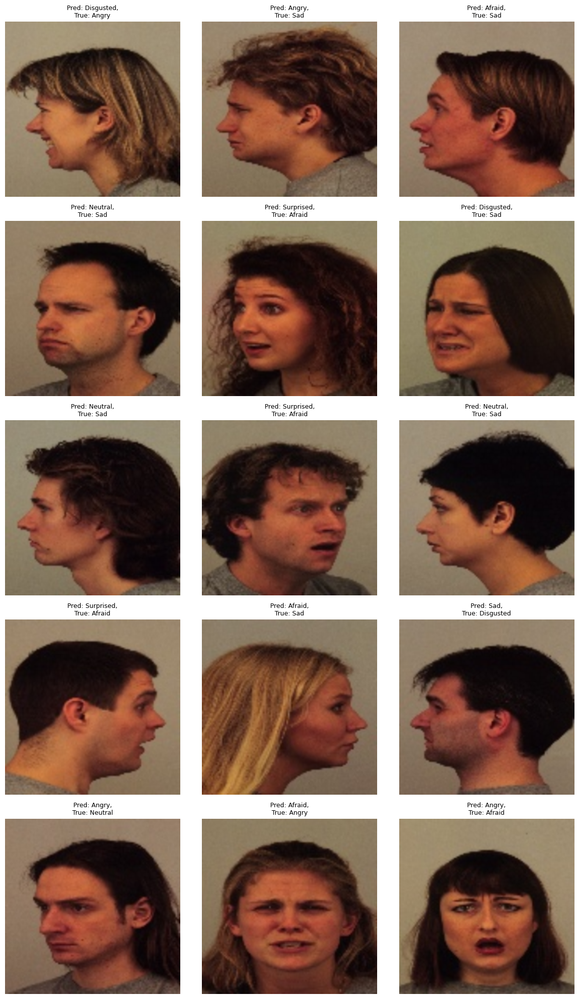




------------------------------------
 Accuracies  [0.9265306122448981, 0.9367346938775512, 0.9061224489795919, 0.9244897959183674, 0.9510204081632654, 0.9306122448979592]



Epoch 0/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.05it/s]


train Loss: 1.6328 Acc: 0.3633


100%|██████████| 16/16 [00:00<00:00, 17.90it/s]


val Loss: 1.1055 Acc: 0.5735

Epoch 1/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.22it/s]


train Loss: 0.7981 Acc: 0.7091


100%|██████████| 16/16 [00:01<00:00, 15.98it/s]


val Loss: 0.6995 Acc: 0.7571

Epoch 2/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.04it/s]


train Loss: 0.4576 Acc: 0.8426


100%|██████████| 16/16 [00:00<00:00, 16.35it/s]


val Loss: 0.5339 Acc: 0.7980

Epoch 3/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.23it/s]


train Loss: 0.3160 Acc: 0.8882


100%|██████████| 16/16 [00:00<00:00, 17.95it/s]


val Loss: 0.4676 Acc: 0.8408

Epoch 4/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.07it/s]


train Loss: 0.2192 Acc: 0.9327


100%|██████████| 16/16 [00:01<00:00, 14.57it/s]


val Loss: 0.4218 Acc: 0.8755

Epoch 5/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.31it/s]


train Loss: 0.1398 Acc: 0.9601


100%|██████████| 16/16 [00:00<00:00, 17.75it/s]


val Loss: 0.3638 Acc: 0.8796

Epoch 6/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.24it/s]


train Loss: 0.1200 Acc: 0.9689


100%|██████████| 16/16 [00:00<00:00, 18.03it/s]


val Loss: 0.3592 Acc: 0.8857

Epoch 7/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.51it/s]


train Loss: 0.1101 Acc: 0.9732


100%|██████████| 16/16 [00:00<00:00, 18.17it/s]


val Loss: 0.3432 Acc: 0.8878

Epoch 8/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.29it/s]


train Loss: 0.0959 Acc: 0.9816


100%|██████████| 16/16 [00:00<00:00, 17.85it/s]


val Loss: 0.3479 Acc: 0.8816

Epoch 9/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.00it/s]


train Loss: 0.0923 Acc: 0.9805


100%|██████████| 16/16 [00:00<00:00, 17.37it/s]


val Loss: 0.3426 Acc: 0.8918

Epoch 10/19
----------


100%|██████████| 138/138 [00:10<00:00, 12.79it/s]


train Loss: 0.0923 Acc: 0.9807


100%|██████████| 16/16 [00:00<00:00, 16.92it/s]


val Loss: 0.3377 Acc: 0.9020

Epoch 11/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.12it/s]


train Loss: 0.0798 Acc: 0.9825


100%|██████████| 16/16 [00:00<00:00, 16.93it/s]


val Loss: 0.3379 Acc: 0.9000

Epoch 12/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.05it/s]


train Loss: 0.0820 Acc: 0.9832


100%|██████████| 16/16 [00:00<00:00, 17.70it/s]


val Loss: 0.3448 Acc: 0.8878

Epoch 13/19
----------


100%|██████████| 138/138 [00:10<00:00, 12.96it/s]


train Loss: 0.0800 Acc: 0.9834


100%|██████████| 16/16 [00:00<00:00, 17.71it/s]


val Loss: 0.3381 Acc: 0.8980

Epoch 14/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.28it/s]


train Loss: 0.0828 Acc: 0.9825


100%|██████████| 16/16 [00:01<00:00, 14.77it/s]


val Loss: 0.3413 Acc: 0.8939

Epoch 15/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.22it/s]


train Loss: 0.0863 Acc: 0.9803


100%|██████████| 16/16 [00:00<00:00, 17.74it/s]


val Loss: 0.3388 Acc: 0.8918

Epoch 16/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.21it/s]


train Loss: 0.0807 Acc: 0.9823


100%|██████████| 16/16 [00:00<00:00, 16.14it/s]


val Loss: 0.3412 Acc: 0.8898

Epoch 17/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.23it/s]


train Loss: 0.0803 Acc: 0.9828


100%|██████████| 16/16 [00:00<00:00, 16.08it/s]


val Loss: 0.3388 Acc: 0.8939

Epoch 18/19
----------


100%|██████████| 138/138 [00:10<00:00, 12.93it/s]


train Loss: 0.0825 Acc: 0.9834


100%|██████████| 16/16 [00:00<00:00, 17.77it/s]


val Loss: 0.3403 Acc: 0.8980

Epoch 19/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.12it/s]


train Loss: 0.0847 Acc: 0.9814


100%|██████████| 16/16 [00:00<00:00, 16.93it/s]


val Loss: 0.3374 Acc: 0.8898

Training complete in 3m 50s
Best val Acc: 0.902041
Showing misclassified examples for fold 6...


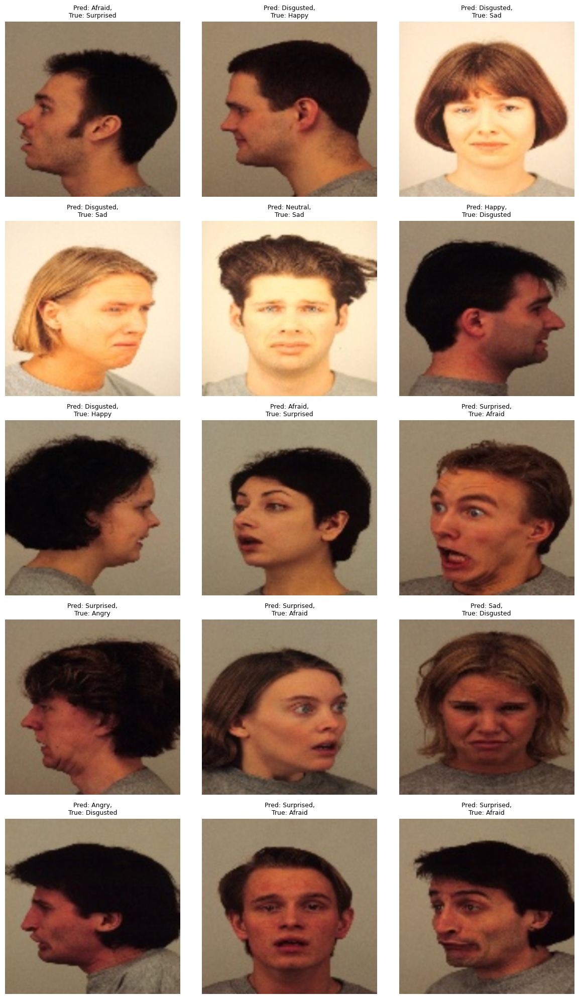




------------------------------------
 Accuracies  [0.9265306122448981, 0.9367346938775512, 0.9061224489795919, 0.9244897959183674, 0.9510204081632654, 0.9306122448979592, 0.9020408163265307]



Epoch 0/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.22it/s]


train Loss: 1.6188 Acc: 0.3617


100%|██████████| 16/16 [00:00<00:00, 16.80it/s]


val Loss: 1.0951 Acc: 0.5980

Epoch 1/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.40it/s]


train Loss: 0.8046 Acc: 0.7095


100%|██████████| 16/16 [00:00<00:00, 17.62it/s]


val Loss: 0.5772 Acc: 0.8020

Epoch 2/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.19it/s]


train Loss: 0.4557 Acc: 0.8451


100%|██████████| 16/16 [00:00<00:00, 16.50it/s]


val Loss: 0.4262 Acc: 0.8388

Epoch 3/19
----------


100%|██████████| 138/138 [00:10<00:00, 12.98it/s]


train Loss: 0.3112 Acc: 0.8946


100%|██████████| 16/16 [00:01<00:00, 14.98it/s]


val Loss: 0.3770 Acc: 0.8510

Epoch 4/19
----------


100%|██████████| 138/138 [00:10<00:00, 12.81it/s]


train Loss: 0.2147 Acc: 0.9290


100%|██████████| 16/16 [00:00<00:00, 17.72it/s]


val Loss: 0.3517 Acc: 0.8857

Epoch 5/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.40it/s]


train Loss: 0.1350 Acc: 0.9642


100%|██████████| 16/16 [00:00<00:00, 16.51it/s]


val Loss: 0.2616 Acc: 0.9143

Epoch 6/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.13it/s]


train Loss: 0.1130 Acc: 0.9739


100%|██████████| 16/16 [00:00<00:00, 16.91it/s]


val Loss: 0.2667 Acc: 0.9041

Epoch 7/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.17it/s]


train Loss: 0.1098 Acc: 0.9735


100%|██████████| 16/16 [00:00<00:00, 17.60it/s]


val Loss: 0.2635 Acc: 0.9020

Epoch 8/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.23it/s]


train Loss: 0.0975 Acc: 0.9794


100%|██████████| 16/16 [00:00<00:00, 17.70it/s]


val Loss: 0.2734 Acc: 0.9000

Epoch 9/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.27it/s]


train Loss: 0.1019 Acc: 0.9760


100%|██████████| 16/16 [00:00<00:00, 17.64it/s]


val Loss: 0.2642 Acc: 0.9082

Epoch 10/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.20it/s]


train Loss: 0.0916 Acc: 0.9803


100%|██████████| 16/16 [00:00<00:00, 17.73it/s]


val Loss: 0.2673 Acc: 0.9061

Epoch 11/19
----------


100%|██████████| 138/138 [00:10<00:00, 12.91it/s]


train Loss: 0.0863 Acc: 0.9832


100%|██████████| 16/16 [00:00<00:00, 16.52it/s]


val Loss: 0.2657 Acc: 0.9061

Epoch 12/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.09it/s]


train Loss: 0.0885 Acc: 0.9794


100%|██████████| 16/16 [00:00<00:00, 17.66it/s]


val Loss: 0.2608 Acc: 0.9122

Epoch 13/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.21it/s]


train Loss: 0.0858 Acc: 0.9805


100%|██████████| 16/16 [00:00<00:00, 17.85it/s]


val Loss: 0.2608 Acc: 0.9143

Epoch 14/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.24it/s]


train Loss: 0.0822 Acc: 0.9853


100%|██████████| 16/16 [00:01<00:00, 15.72it/s]


val Loss: 0.2643 Acc: 0.9102

Epoch 15/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.35it/s]


train Loss: 0.0871 Acc: 0.9825


100%|██████████| 16/16 [00:00<00:00, 17.63it/s]


val Loss: 0.2639 Acc: 0.9102

Epoch 16/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.15it/s]


train Loss: 0.0831 Acc: 0.9841


100%|██████████| 16/16 [00:00<00:00, 17.83it/s]


val Loss: 0.2620 Acc: 0.9061

Epoch 17/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.05it/s]


train Loss: 0.0799 Acc: 0.9841


100%|██████████| 16/16 [00:00<00:00, 17.89it/s]


val Loss: 0.2586 Acc: 0.9143

Epoch 18/19
----------


100%|██████████| 138/138 [00:10<00:00, 12.94it/s]


train Loss: 0.0851 Acc: 0.9819


100%|██████████| 16/16 [00:00<00:00, 17.65it/s]


val Loss: 0.2705 Acc: 0.9020

Epoch 19/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.21it/s]


train Loss: 0.0819 Acc: 0.9855


100%|██████████| 16/16 [00:00<00:00, 17.71it/s]


val Loss: 0.2604 Acc: 0.9082

Training complete in 3m 49s
Best val Acc: 0.914286
Showing misclassified examples for fold 7...


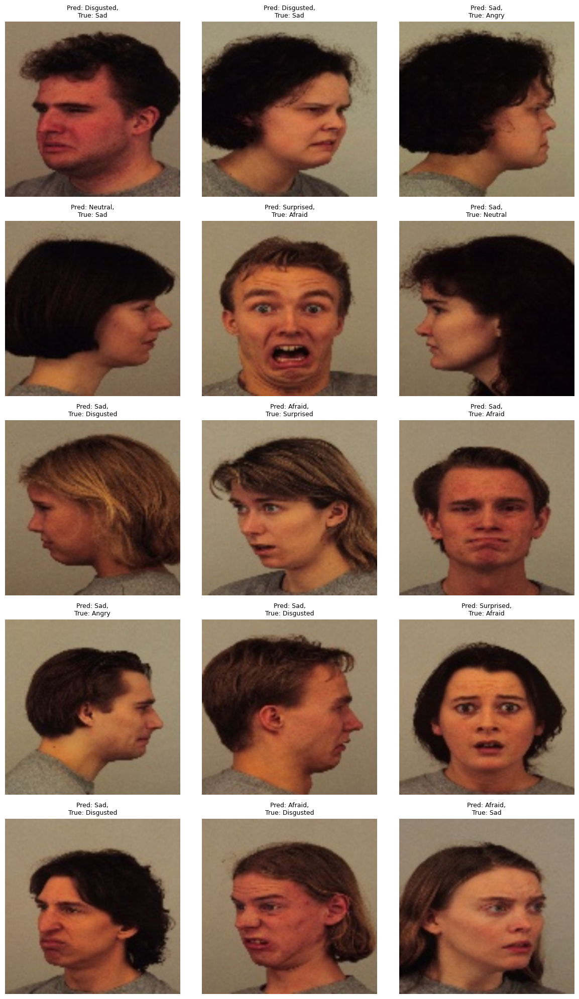




------------------------------------
 Accuracies  [0.9265306122448981, 0.9367346938775512, 0.9061224489795919, 0.9244897959183674, 0.9510204081632654, 0.9306122448979592, 0.9020408163265307, 0.9142857142857144]



Epoch 0/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.39it/s]


train Loss: 1.5914 Acc: 0.3764


100%|██████████| 16/16 [00:00<00:00, 17.78it/s]


val Loss: 1.0365 Acc: 0.6531

Epoch 1/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.08it/s]


train Loss: 0.7680 Acc: 0.7274


100%|██████████| 16/16 [00:00<00:00, 18.01it/s]


val Loss: 0.7239 Acc: 0.7082

Epoch 2/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.20it/s]


train Loss: 0.4522 Acc: 0.8417


100%|██████████| 16/16 [00:00<00:00, 16.07it/s]


val Loss: 0.4517 Acc: 0.8367

Epoch 3/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.53it/s]


train Loss: 0.2904 Acc: 0.9100


100%|██████████| 16/16 [00:00<00:00, 17.86it/s]


val Loss: 0.4159 Acc: 0.8388

Epoch 4/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.36it/s]


train Loss: 0.2024 Acc: 0.9374


100%|██████████| 16/16 [00:00<00:00, 17.28it/s]


val Loss: 0.4202 Acc: 0.8388

Epoch 5/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.09it/s]


train Loss: 0.1308 Acc: 0.9673


100%|██████████| 16/16 [00:00<00:00, 17.82it/s]


val Loss: 0.2707 Acc: 0.9061

Epoch 6/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.26it/s]


train Loss: 0.1155 Acc: 0.9710


100%|██████████| 16/16 [00:00<00:00, 17.36it/s]


val Loss: 0.2538 Acc: 0.9143

Epoch 7/19
----------


100%|██████████| 138/138 [00:10<00:00, 12.86it/s]


train Loss: 0.1061 Acc: 0.9773


100%|██████████| 16/16 [00:00<00:00, 16.70it/s]


val Loss: 0.2556 Acc: 0.9184

Epoch 8/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.08it/s]


train Loss: 0.0929 Acc: 0.9807


100%|██████████| 16/16 [00:00<00:00, 17.44it/s]


val Loss: 0.2427 Acc: 0.9245

Epoch 9/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.00it/s]


train Loss: 0.0940 Acc: 0.9807


100%|██████████| 16/16 [00:00<00:00, 16.67it/s]


val Loss: 0.2560 Acc: 0.9143

Epoch 10/19
----------


100%|██████████| 138/138 [00:10<00:00, 12.98it/s]


train Loss: 0.0872 Acc: 0.9834


100%|██████████| 16/16 [00:00<00:00, 17.65it/s]


val Loss: 0.2491 Acc: 0.9224

Epoch 11/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.32it/s]


train Loss: 0.0886 Acc: 0.9805


100%|██████████| 16/16 [00:00<00:00, 17.31it/s]


val Loss: 0.2474 Acc: 0.9224

Epoch 12/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.19it/s]


train Loss: 0.0813 Acc: 0.9821


100%|██████████| 16/16 [00:00<00:00, 17.73it/s]


val Loss: 0.2433 Acc: 0.9204

Epoch 13/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.04it/s]


train Loss: 0.0788 Acc: 0.9819


100%|██████████| 16/16 [00:00<00:00, 17.12it/s]


val Loss: 0.2410 Acc: 0.9224

Epoch 14/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.05it/s]


train Loss: 0.0762 Acc: 0.9848


100%|██████████| 16/16 [00:00<00:00, 17.69it/s]


val Loss: 0.2462 Acc: 0.9204

Epoch 15/19
----------


100%|██████████| 138/138 [00:10<00:00, 12.83it/s]


train Loss: 0.0828 Acc: 0.9844


100%|██████████| 16/16 [00:00<00:00, 17.65it/s]


val Loss: 0.2439 Acc: 0.9224

Epoch 16/19
----------


100%|██████████| 138/138 [00:10<00:00, 12.98it/s]


train Loss: 0.0772 Acc: 0.9853


100%|██████████| 16/16 [00:00<00:00, 16.67it/s]


val Loss: 0.2470 Acc: 0.9143

Epoch 17/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.13it/s]


train Loss: 0.0796 Acc: 0.9857


100%|██████████| 16/16 [00:00<00:00, 17.25it/s]


val Loss: 0.2444 Acc: 0.9163

Epoch 18/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.20it/s]


train Loss: 0.0766 Acc: 0.9853


100%|██████████| 16/16 [00:00<00:00, 17.41it/s]


val Loss: 0.2465 Acc: 0.9143

Epoch 19/19
----------


100%|██████████| 138/138 [00:10<00:00, 12.93it/s]


train Loss: 0.0833 Acc: 0.9821


100%|██████████| 16/16 [00:00<00:00, 17.55it/s]


val Loss: 0.2446 Acc: 0.9204

Training complete in 3m 50s
Best val Acc: 0.924490
Showing misclassified examples for fold 8...


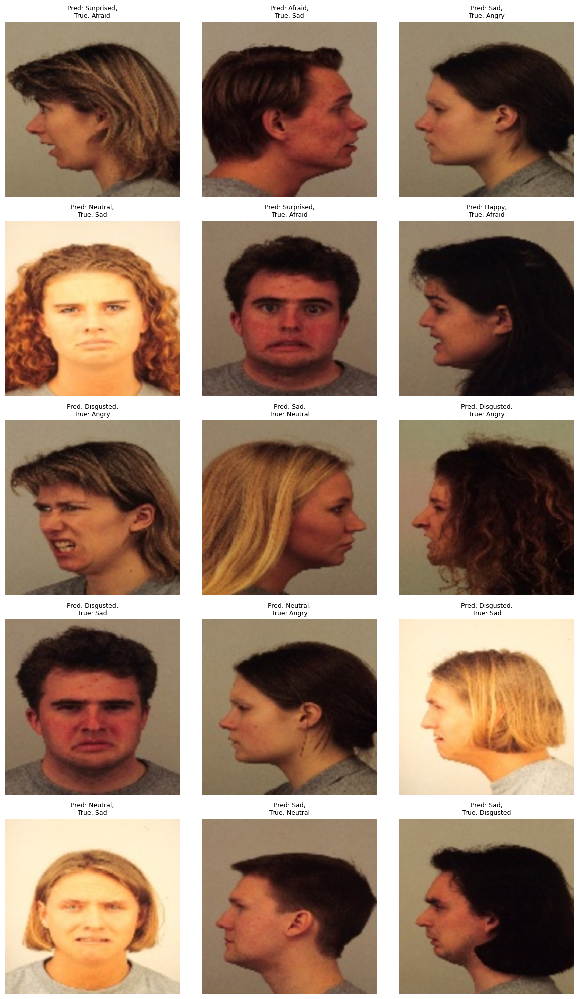




------------------------------------
 Accuracies  [0.9265306122448981, 0.9367346938775512, 0.9061224489795919, 0.9244897959183674, 0.9510204081632654, 0.9306122448979592, 0.9020408163265307, 0.9142857142857144, 0.9244897959183674]



Epoch 0/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.33it/s]


train Loss: 1.5864 Acc: 0.3796


100%|██████████| 16/16 [00:00<00:00, 17.15it/s]


val Loss: 1.1269 Acc: 0.5735

Epoch 1/19
----------


100%|██████████| 138/138 [00:10<00:00, 12.87it/s]


train Loss: 0.7736 Acc: 0.7261


100%|██████████| 16/16 [00:01<00:00, 15.77it/s]


val Loss: 0.6910 Acc: 0.7694

Epoch 2/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.51it/s]


train Loss: 0.4467 Acc: 0.8438


100%|██████████| 16/16 [00:00<00:00, 17.57it/s]


val Loss: 0.5437 Acc: 0.8041

Epoch 3/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.26it/s]


train Loss: 0.3139 Acc: 0.8934


100%|██████████| 16/16 [00:00<00:00, 17.01it/s]


val Loss: 0.5285 Acc: 0.7918

Epoch 4/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.37it/s]


train Loss: 0.2016 Acc: 0.9374


100%|██████████| 16/16 [00:00<00:00, 16.15it/s]


val Loss: 0.4699 Acc: 0.8490

Epoch 5/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.41it/s]


train Loss: 0.1343 Acc: 0.9626


100%|██████████| 16/16 [00:00<00:00, 17.34it/s]


val Loss: 0.3395 Acc: 0.8857

Epoch 6/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.25it/s]


train Loss: 0.1146 Acc: 0.9723


100%|██████████| 16/16 [00:00<00:00, 18.26it/s]


val Loss: 0.3342 Acc: 0.8837

Epoch 7/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.07it/s]


train Loss: 0.1072 Acc: 0.9769


100%|██████████| 16/16 [00:00<00:00, 18.25it/s]


val Loss: 0.3328 Acc: 0.8837

Epoch 8/19
----------


100%|██████████| 138/138 [00:10<00:00, 12.99it/s]


train Loss: 0.1004 Acc: 0.9744


100%|██████████| 16/16 [00:00<00:00, 17.88it/s]


val Loss: 0.3218 Acc: 0.8857

Epoch 9/19
----------


100%|██████████| 138/138 [00:10<00:00, 12.96it/s]


train Loss: 0.0944 Acc: 0.9776


100%|██████████| 16/16 [00:00<00:00, 17.91it/s]


val Loss: 0.3213 Acc: 0.8898

Epoch 10/19
----------


100%|██████████| 138/138 [00:10<00:00, 12.94it/s]


train Loss: 0.0878 Acc: 0.9812


100%|██████████| 16/16 [00:00<00:00, 17.70it/s]


val Loss: 0.3110 Acc: 0.8837

Epoch 11/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.37it/s]


train Loss: 0.0911 Acc: 0.9789


100%|██████████| 16/16 [00:00<00:00, 17.17it/s]


val Loss: 0.3116 Acc: 0.8898

Epoch 12/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.02it/s]


train Loss: 0.0818 Acc: 0.9830


100%|██████████| 16/16 [00:00<00:00, 17.87it/s]


val Loss: 0.3087 Acc: 0.8898

Epoch 13/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.24it/s]


train Loss: 0.0800 Acc: 0.9844


100%|██████████| 16/16 [00:00<00:00, 17.30it/s]


val Loss: 0.3082 Acc: 0.8878

Epoch 14/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.27it/s]


train Loss: 0.0788 Acc: 0.9828


100%|██████████| 16/16 [00:00<00:00, 17.61it/s]


val Loss: 0.3108 Acc: 0.8918

Epoch 15/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.26it/s]


train Loss: 0.0833 Acc: 0.9825


100%|██████████| 16/16 [00:00<00:00, 17.43it/s]


val Loss: 0.3058 Acc: 0.8918

Epoch 16/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.31it/s]


train Loss: 0.0812 Acc: 0.9855


100%|██████████| 16/16 [00:00<00:00, 17.77it/s]


val Loss: 0.3156 Acc: 0.8980

Epoch 17/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.11it/s]


train Loss: 0.0800 Acc: 0.9841


100%|██████████| 16/16 [00:00<00:00, 17.30it/s]


val Loss: 0.3130 Acc: 0.8918

Epoch 18/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.49it/s]


train Loss: 0.0838 Acc: 0.9816


100%|██████████| 16/16 [00:00<00:00, 18.12it/s]


val Loss: 0.3091 Acc: 0.8959

Epoch 19/19
----------


100%|██████████| 138/138 [00:10<00:00, 13.13it/s]


train Loss: 0.0850 Acc: 0.9810


100%|██████████| 16/16 [00:00<00:00, 17.91it/s]


val Loss: 0.3083 Acc: 0.8918

Training complete in 3m 48s
Best val Acc: 0.897959
Showing misclassified examples for fold 9...


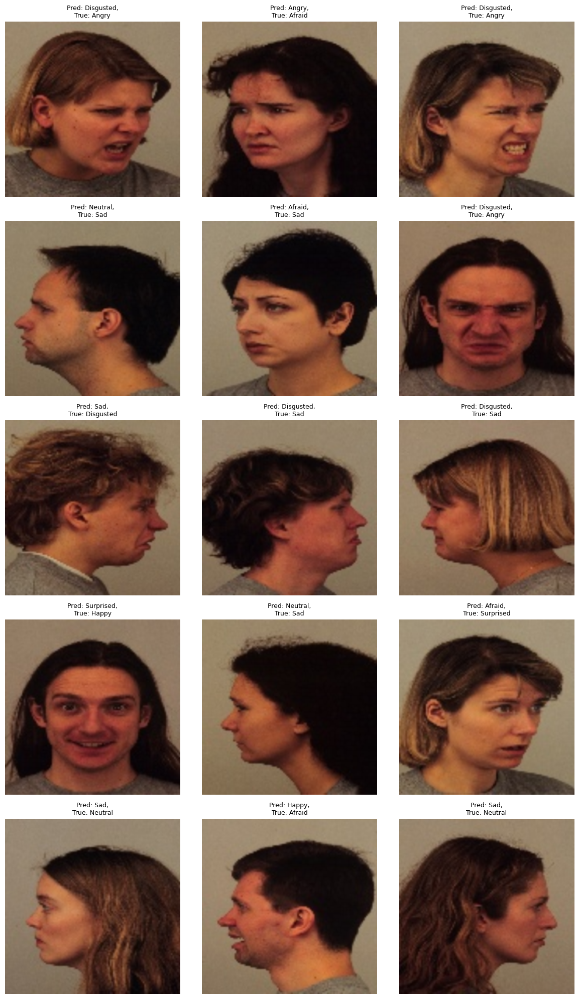




------------------------------------
 Accuracies  [0.9265306122448981, 0.9367346938775512, 0.9061224489795919, 0.9244897959183674, 0.9510204081632654, 0.9306122448979592, 0.9020408163265307, 0.9142857142857144, 0.9244897959183674, 0.8979591836734695]





In [11]:
accuracies = []
index = list(np.random.permutation(4900))

for i in range(10):
    idx = {
        'val': index[490 * i:490 * (i + 1)],
        'train': index[:i * 490] + index[((i + 1) * 490):]
    }

    dataloaders = {
        x: torch.utils.data.DataLoader(
            KDEFDataset(transforms_=data_transforms[x], idx=idx[x]),
            batch_size=32,
            shuffle=True
        )
        for x in ['train', 'val']
    }

    model_ft = models.resnet18(weights='IMAGENET1K_V1')
    num_ftrs = model_ft.fc.in_features
    model_ft.fc = nn.Linear(num_ftrs, class_names)
    model_ft = model_ft.to(device)

    criterion = nn.CrossEntropyLoss()
    optimizer_ft = optim.SGD(model_ft.parameters(), lr=0.001, momentum=0.9)
    exp_lr_scheduler = lr_scheduler.StepLR(optimizer_ft, step_size=6, gamma=0.1)

    logdir = f'./logs/resnet18_kfold_{i}'
    os.makedirs(logdir, exist_ok=True)  # Ensure logs dir exists
    writer = SummaryWriter(logdir)

    # 🛠️ ensure "saved" directory exists before saving the model
    os.makedirs('saved', exist_ok=True)

    model_ft, best_acc = train_model(
        model_ft,
        criterion,
        optimizer_ft,
        exp_lr_scheduler,
        dataloaders,
        writer,
        i,
        num_epochs=20
    )

    # Save model
    torch.save(model_ft.state_dict(), f'saved/model_fold_{i}.pt')

    print(f"Showing misclassified examples for fold {i}...")
    visualize_model_misclassified(
    model=model_ft,
    dataloader=dataloaders['val'],
    class_names={
        0: "Afraid", 1: "Angry", 2: "Disgusted",
        3: "Happy", 4: "Neutral", 5: "Sad", 6: "Surprised"
    },
    save_dir=f'misclassified/fold_{i}',
    num_images=15,

)

    accuracies.append(float(best_acc.cpu().numpy()))
    print("\n\n\n------------------------------------\n Accuracies ", accuracies)
    print("\n\n")



In [12]:
from google.colab import files

!zip -r resnet18_112x112_logs_and_saved_misclassified.zip logs saved misclassified
files.download('resnet18_112x112_logs_and_saved_misclassified.zip')

  adding: logs/ (stored 0%)
  adding: logs/resnet18_kfold_3/ (stored 0%)
  adding: logs/resnet18_kfold_3/events.out.tfevents.1744896677.1bb0eb478ea9 (deflated 62%)
  adding: logs/resnet18_kfold_2/ (stored 0%)
  adding: logs/resnet18_kfold_2/events.out.tfevents.1744896447.1bb0eb478ea9 (deflated 62%)
  adding: logs/resnet18_kfold_4/ (stored 0%)
  adding: logs/resnet18_kfold_4/events.out.tfevents.1744896909.1bb0eb478ea9 (deflated 62%)
  adding: logs/resnet18_kfold_6/ (stored 0%)
  adding: logs/resnet18_kfold_6/events.out.tfevents.1744897372.1bb0eb478ea9 (deflated 62%)
  adding: logs/resnet18_kfold_7/ (stored 0%)
  adding: logs/resnet18_kfold_7/events.out.tfevents.1744897605.1bb0eb478ea9 (deflated 62%)
  adding: logs/resnet18_kfold_1/ (stored 0%)
  adding: logs/resnet18_kfold_1/events.out.tfevents.1744896221.1bb0eb478ea9 (deflated 62%)
  adding: logs/resnet18_kfold_5/ (stored 0%)
  adding: logs/resnet18_kfold_5/events.out.tfevents.1744897140.1bb0eb478ea9 (deflated 62%)
  adding: logs/resne

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>